### All of the Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

import requests
import json
import csv

from os import sep, makedirs
from os.path import dirname, realpath, join, isdir, exists

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
%matplotlib inline

---

### Loading Data

In [2]:
uppath = lambda _path, n: sep.join(_path.split(sep)[:-n]) # moves the path 'n' levels up the directory

__file__ = dirname(realpath('__file__'))
data_parent_directory = uppath(__file__, 2)
data_directory = join(data_parent_directory, 'Data')
root_directory = join(data_directory, 'covid-india')

In [3]:
def load_data(root_directory, file_name, delimit=None, quot=0, encoding=None, parse_dates=None):
    file_path = join(root_directory, file_name)
    return pd.read_csv(file_path, delimiter=delimit, quoting=quot, encoding=encoding, parse_dates=parse_dates)

In [4]:
covid_data = load_data(root_directory, 'covid_state_wise.csv')
patients_data = load_data(root_directory, 'patients_data.csv')
pollution_data = load_data(root_directory, 'pollution_1990_2015.csv', encoding='latin1', parse_dates=['date'])

C:\Users\AVINASH AKELLA\AppData\Local\Enthought\Canopy\edm\envs\User\lib\site-packages\IPython\core\interactiveshell.py:2821: DtypeWarning:

Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.



In [5]:
covid_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1365 entries, 0 to 1364
Data columns (total 9 columns):
Date                                          1365 non-null object
Name of State / UT                            1365 non-null object
Total Confirmed cases (Indian National)       1365 non-null int64
Total Confirmed cases ( Foreign National )    1365 non-null int64
Cured/Discharged/Migrated                     1365 non-null int64
Latitude                                      1365 non-null float64
Longitude                                     1365 non-null float64
Death                                         1365 non-null int64
Total Confirmed cases                         1365 non-null int64
dtypes: float64(2), int64(5), object(2)
memory usage: 96.1+ KB


In [6]:
pollution_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 435742 entries, 0 to 435741
Data columns (total 13 columns):
stn_code                       291665 non-null object
sampling_date                  435739 non-null object
state                          435742 non-null object
location                       435739 non-null object
agency                         286261 non-null object
type                           430349 non-null object
so2                            401096 non-null float64
no2                            419509 non-null float64
rspm                           395520 non-null float64
spm                            198355 non-null float64
location_monitoring_station    408251 non-null object
pm2_5                          9314 non-null float64
date                           435735 non-null datetime64[ns]
dtypes: datetime64[ns](1), float64(5), object(7)
memory usage: 43.2+ MB


In [7]:
patients_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27890 entries, 0 to 27889
Data columns (total 21 columns):
patient_number                             27890 non-null int64
p_id                                       27890 non-null object
state_patient_number                       2997 non-null object
date_announced                             27890 non-null object
age_bracket                                2346 non-null object
gender                                     5313 non-null object
detected_city                              2347 non-null object
detected_district                          20246 non-null object
detected_state                             27890 non-null object
state_code                                 27890 non-null object
nationality                                2707 non-null object
type_of_transmission                       2990 non-null object
contracted_from_which_patient_suspected    1563 non-null object
status_change_date                         27780 non-n

---

### Cleaning and Pre-processing

It's important for states in pollution data and covid19 data to match. There are some obvious discrepancies that we need to fix.
<br>Most of the cleaning is analyzed and done here. Those identified at a later stage also are addressed here only.

Pollution data is upto 2015. Andhra Pradesh has since split into different states: Andhra Pradesh and Telangana.
<br>Let's separate them based on 'location' or city info.

In [8]:
pollution_data[pollution_data['state'] == 'Andhra Pradesh']['location'].unique()

array(['Hyderabad', 'Vishakhapatnam', 'Visakhapatnam', 'Tirupati',
       'Vijayawada', 'Patancheru', 'Ramagundam', 'Kurnool', 'Guntur',
       'Nalgonda', 'Nellore', 'Warangal', 'Chittoor', 'Khammam',
       'Kakinada', 'Ananthapur', 'Eluru', 'Kadapa', 'Karimnagar',
       'Nizamabad', 'Ongole', 'Rajahmundry', 'Sangareddy', 'Srikakulam',
       'Vizianagaram'], dtype=object)

Cities that are now part of Telengana are: Hyderabad, Patancheru, Ramagundam, Nalgonda, Warangal, Khammam, Karimnagar, Nizamabad, Sangareddy
<br>Also notice that 'Vishakhapatnam', 'Visakhapatnam' are the same thing. We'll handle handle that also.

---
Moving on, let's look at the states that match between the two datasets.

In [9]:
pollution_states = pollution_data['state'].unique()
covid_states = covid_data['Name of State / UT'].unique()

common_states = []
for poll_state in pollution_states:
    if poll_state in covid_states:
        common_states.append(poll_state)
len(common_states)

28

Many match, fortunately. Let's see why the others don't.

In [10]:
[state for state in pollution_states if state not in common_states]

['Dadra & Nagar Haveli',
 'Daman & Diu',
 'Jammu & Kashmir',
 'Nagaland',
 'Sikkim',
 'Telangana',
 'Uttaranchal',
 'andaman-and-nicobar-islands',
 'Lakshadweep']

In [11]:
[state for state in covid_states if state not in common_states]

['Telengana',
 'Union Territory of Ladakh',
 'Union Territory of Jammu and Kashmir',
 'Union Territory of Chandigarh',
 'Jammu and Kashmir',
 'Ladakh',
 'Andaman and Nicobar Islands']

In [12]:
pollution_data[pollution_data['state'] == 'Jammu & Kashmir']['location'].unique()

array(['Jammu'], dtype=object)

Let's leave Telangana for now. We'll shortly handle it.
<br>'Andaman and Nicobar Islands' has a name mismatch. Jammu and Kasmir is a little more complicated than that.

Pollution data in 'Jammu & Kashmir' state is present only for 'Jammu' city.
<br>But why do we have both 'Union Territory of Jammu and Kashmir' & 'Jammu and Kashmir' in covid data? Now that it's a UT. Let's see.

In [13]:
covid_data[covid_data['Name of State / UT'] == 'Union Territory of Jammu and Kashmir']['Date'].max()

'2020-03-20'

In [14]:
covid_data[covid_data['Name of State / UT'] == 'Jammu and Kashmir']['Date'].min()

'2020-03-21'

Seems like the covid data for J&K was recorded under the name of 'Union Territory of Jammu and Kashmir' unitl 21st, March
<br>and under 'Jammu and Kashmir' for future dates. So let's just merge them into 'Jammu and Kashmir'

And here are the Replacements
<br>For covid_data:
<br>'Union Territory of Jammu and Kashmir' with 'Jammu and Kashmir'
<br>'Telengana' with 'Telangana'
<br>For pollution_data:
<br>'Jammu & Kashmir' with  'Jammu and Kashmir',
<br>'andaman-and-nicobar-islands' with 'Andaman and Nicobar Islands'
<br>'Vishakhapatnam' with 'Visakhapatnam'
<br>Splitting Andhra Pradesh and Telangana

In [15]:
state_dict = {'Telengana': 'Telangana', 'Union Territory of Jammu and Kashmir': 'Jammu and Kashmir'}
covid_data['Name of State / UT'].replace(state_dict, inplace=True)


telangana_cities = ['Hyderabad', 'Patancheru', 'Ramagundam', 'Nalgonda', 'Warangal', 'Khammam', 'Karimnagar', 'Nizamabad', 'Sangareddy']

def clean_pollution(data):
    if data['location'] in telangana_cities:
        data['state']= 'Telengana'
    elif data['location'] == 'Vishakhapatnam':
        data['location'] = 'Visakhapatnam'
    elif data['state'] == 'Jammu & Kashmir':
        data['state'] = 'Jammu and Kashmir'
    elif data['state'] == 'andaman-and-nicobar-islands':
        data['state'] = 'Andaman and Nicobar Islands'
    return data

pollution_data = pollution_data.apply(clean_pollution, axis=1)

In [16]:
pollution_states = pollution_data['state'].unique()
covid_states = covid_data['Name of State / UT'].unique()

common_states = []
for poll_state in pollution_states:
    if poll_state in covid_states:
        common_states.append(poll_state)
len(common_states)

31

Cool! 31 states match. That's pretty good.

In [17]:
pollution_data['type'].value_counts()

Residential, Rural and other Areas    179014
Industrial Area                        96091
Residential and others                 86791
Industrial Areas                       51747
Sensitive Area                          8980
Sensitive Areas                         5536
RIRUO                                   1304
Sensitive                                495
Industrial                               233
Residential                              158
Name: type, dtype: int64

Let's generalize them into three broad categories: Residential, Industrial, Sensitive.
<br>I counldn't find what RIRUO is, so I'll just club it with Residential. 

In [18]:
typeDict = {'Residential, Rural and other Areas': 'Residential',
            'Residential and others': 'Residential',
            'RIRUO': 'Residential',
            'Industrial Area': 'Industrial',
            'Industrial Areas': 'Industrial',
            'Sensitive Area': 'Sensitive',
            'Sensitive Areas': 'Sensitive',
           }
pollution_data.replace({'type': typeDict}, inplace=True)
pollution_data.replace('Bangalore', 'Bengaluru', inplace=True) ## To match with patients_data. Identified later on.

I noticed that data for some of the states has not been recorded at all. Let's check.

In [19]:
not_recorded = ['Andaman and Nicobar Islands', 'Tripura', 'Lakshadweep']

unrecorded_pollution = pollution_data[pollution_data['state'].isin(not_recorded)]
unrecorded_pollution.head()

,stn_code,sampling_date,state,location,agency,type,so2,no2,rspm,spm,location_monitoring_station,pm2_5,date
435739,NaN,NaN,Andaman and Nicobar Islands,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
435740,NaN,NaN,Lakshadweep,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
435741,NaN,NaN,Tripura,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT


It's true, there's no data at all. Let's remove them.

In [20]:
pollution_data.drop(pollution_data[pollution_data['state'].isin(not_recorded)].index, inplace=True)

I also came across 'estimated_onset_date' column that doesn't have any values at all. Let's check and drop it.

In [21]:
patients_data['estimated_onset_date'].isnull().sum() == patients_data.shape[0]

True

Drop it.

In [22]:
patients_data.drop('estimated_onset_date', axis=1, inplace=True)

I'm adding a new column that tells how many days it took a patient to recover from covid.

In [23]:
def calc_recovery_days(record):
    
    if type(record['status_change_date']) == str and record['current_status'] == 'Recovered':
        result = pd.to_datetime(record['status_change_date'], format='%d/%m/%Y') - pd.to_datetime(record['date_announced'], format='%d/%m/%Y')
        record['recovery_days'] = result.days
    else:
        record['recovery_days'] =  np.NaN
    return record

patients_data = patients_data.apply(calc_recovery_days, axis=1)

Ages stored under the age-bracket column are in the string format and one age is '28-35'. Let's handle this

In [24]:
patients_data['age_bracket'].replace('28-35', '30', inplace=True)
patients_data['age_bracket'] = patients_data['age_bracket'].astype(float)

---

### Visualizations

I'll be using a small JS work-around for toggling the input cells.
<br>This'll help us focus on the visualizations better.
<br>I inspired from this <a href="https://stackoverflow.com/questions/27934885/how-to-hide-code-from-cells-in-ipython-notebook-visualized-with-nbviewer">Stackoverflow</a> answer and modified it to fit my requirements.



<br>If you're interested in the change, here are the details:
<br>1: The Stackoverflow answer was toggling inputs for the entire notebook. I wanted only for select cells, especially visualizations.
<br>2: Also, they implemented the toggle button as a 'submit' button of a form, which is inappropriate as it's not really a form. It doesn't have any inputs! Just the submit button.
<br>3: So I've removed the form. Then I separated the JS and HTML code. JS code handles the click event toggling. Adding it to the page once is enough.
<br>4: The toggle_input() function returns a button, which the user can use to toggle input of that particular cell.
<br> Kind of how it is on Kaggle. I even put it on the right side of the cell so that it's completely out of the way.

In [25]:
from IPython.display import HTML
from IPython.display import display

''' The JS code to handle toggle event '''
def create_hide_handler():
    
    return HTML('''
    <script> 
        function code_toggle(event) {
             
             button = $(event.currentTarget); 
             input = button.parents('.cell').find('.input');

             if (input.is(':visible')){
                 button[0].value = "Code";
                 input.hide();
             } else {
                 button[0].value = "Hide";
                 input.show();
             }
        }
    </script>
    ''')


# The button used for toggling a cell
# Note: Use display(toggle_input()) to show the button. This will embed the button into the page's HTML.
# Take the example cell:- 
#    toggle_input()
#    train.head()
# This will only execute the last line, so the button won't display. Hence the display function.
def toggle_input():
    return HTML('''
    <input type="button" value="Hide/Show" onclick="javascript:code_toggle(event)" style="background:transparent;border:1px solid black;float:right">
    ''')

# Add the handler JS code to the page. Adding once is enough.
create_hide_handler()

Some minor data preparation for helping us with the visualizations

In [26]:
pollution_cities = [city.lower() for city in pollution_data['location'].unique()]
covid_cities = [city.lower() for city in patients_data[~pd.isnull(patients_data['detected_city'])]['detected_city'].unique()]

common_citites = []
for city in pollution_cities:
    if city in covid_cities:
        common_citites.append(city)
        
print("common cities between pollution and covid datasets: ", len(common_citites))

common cities between pollution and covid datasets:  69


In [27]:
patients_data['current_status'].value_counts()

Hospitalized    27662
Recovered         181
Deceased           46
Migrated            1
Name: current_status, dtype: int64

In [28]:
city_hospitalized = patients_data.groupby('detected_city')['current_status'].apply(lambda x: (x == 'Hospitalized').sum()).reset_index()
city_hospitalized.columns = ['city', 'hospitalized']

city_recovered = patients_data.groupby('detected_city')['current_status'].apply(lambda x: (x == 'Recovered').sum()).reset_index()
city_recovered.columns = ['city', 'recovered']

city_deceased = patients_data.groupby('detected_city')['current_status'].apply(lambda x: (x == 'Deceased').sum()).reset_index()
city_deceased.columns = ['city', 'deceased']

city_recovery_age = patients_data.groupby('detected_city')[['recovery_days', 'age_bracket']].median().reset_index()
city_recovery_age.columns = ['city', 'recovery_days', 'age']



city_patients = city_hospitalized.merge(city_recovered, left_on='city', right_on='city', how='inner').merge(city_deceased,
                                                                        left_on='city', right_on='city', how='inner')

city_patients = city_patients.merge(city_recovery_age, left_on='city', right_on='city', how='left')

city_patients.head()

,city,hospitalized,recovered,deceased,recovery_days,age
0,\n,1,0,0,NaN,NaN
1,,0,0,1,NaN,69.0
2,-,2,0,0,NaN,32.0
3,A-park road,1,0,0,NaN,36.0
4,Agra,4,5,0,11.0,45.0


In [29]:
city_pollution = pollution_data.groupby('location').mean().reset_index()
city_pollution.columns = ['city', 'so2', 'no2', 'rspm', 'spm', 'pm2_5']
city_complete = city_patients.merge(city_pollution, left_on='city', right_on='city', how='inner')
city_complete.head(2)

,city,hospitalized,recovered,deceased,recovery_days,age,so2,no2,rspm,spm,pm2_5
0,Agra,4,5,0,11.0,45.0,6.168916,19.804314,178.757459,364.441858,NaN
1,Ahmedabad,15,1,1,0.0,34.0,14.184336,22.350704,94.315070,217.545965,29.115506


In [30]:
city_complete.shape

(69, 11)

In [31]:
latest_date = covid_data['Date'].max()
latest_covid_data = covid_data[covid_data['Date'] == latest_date]

In [32]:
so2_color = '#fe9801'
no2_color = '#ff2e63'
spm_color = '#21bf73'
rspm_color = '#8205f7'
pm_color = '#f20cee'

Let the visualizations begin!

In [33]:
display(toggle_input())
confirmed_cases = covid_data.groupby('Date')['Total Confirmed cases'].sum()
px.bar(x=confirmed_cases.index, y=confirmed_cases, title='Confirmed Cases', color_discrete_sequence = ['#35495e'])

In [34]:
display(toggle_input())
melted_df = latest_covid_data.melt(value_vars=['Total Confirmed cases', 'Death', 'Cured/Discharged/Migrated'])

fig = px.treemap(melted_df, path=["variable"], values="value", height=400, width=600)
fig.data[0].textinfo = 'label+text+value'
fig.show()

In [35]:
display(toggle_input())
x = latest_covid_data['Name of State / UT']

fig = go.Figure(go.Bar(x=x, y=latest_covid_data['Total Confirmed cases'], name='Total Confirmed cases'))
fig.add_trace(go.Bar(x=x, y=latest_covid_data['Death'], name='Death'))
fig.add_trace(go.Bar(x=x, y=latest_covid_data['Cured/Discharged/Migrated'], name='Recovered'))

fig.update_layout(barmode='stack', title='State Wise Status', xaxis={'categoryorder':'total descending'}, height=700, width=1000)
fig.show()

In [36]:
display(toggle_input())
patients_per_district = patients_data.groupby(['detected_state', 'detected_district'])['patient_number'].count().reset_index()

fig = px.treemap(patients_per_district, path=['detected_state', 'detected_district'], values='patient_number', 
                 title='Patients Per District', height=700, color_discrete_sequence = px.colors.qualitative.Prism)
fig.data[0].textinfo = 'label+text+value'
fig.show()

In [37]:
display(toggle_input())
fig = px.pie(latest_covid_data, values='Total Confirmed cases', names='Name of State / UT', title='Sate-wise Confirmed Case %',
            color_discrete_sequence = px.colors.qualitative.Prism, hole=0.3)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [38]:
display(toggle_input())
fig_c = px.bar(latest_covid_data.sort_values(by='Total Confirmed cases').tail(15), x='Total Confirmed cases',
               y='Name of State / UT', orientation='h', color_discrete_sequence=['#fe9801'], text='Total Confirmed cases')

fig_d = px.bar(latest_covid_data.sort_values(by='Death').tail(15), x='Death', y='Name of State / UT',
       orientation='h', color_discrete_sequence=['#ff2e63'], text='Death')

fig_r = px.bar(latest_covid_data.sort_values(by='Cured/Discharged/Migrated').tail(15), x='Cured/Discharged/Migrated',
       y='Name of State / UT', orientation='h', color_discrete_sequence=['#21bf73'], text='Cured/Discharged/Migrated')


fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('Confirmed cases', 'Deaths reported', 'Recovered'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)
fig.add_trace(fig_r['data'][0], row=1, col=3)

fig.update_layout(title='Top 15 States (Count-wise)', height=700, width=1000)

In [39]:
display(toggle_input())
# ================================================
# Data Preparation
# ================================================

district_geo = gpd.read_file(join(root_directory, 'output.shp'))

states = district_geo.dissolve(by='statename').reset_index()
states['statename'] = states['statename'].str.replace('&', 'and')
states['statename'] = states['statename'].str.replace('NCT of ', '')
states['statename'] = states['statename'].str.replace('Chhatisgarh', 'Chhattisgarh')
states['statename'] = states['statename'].str.replace('Orissa', 'Odisha')
states['statename'] = states['statename'].str.replace('Pondicherry', 'Puducherry')


state_patients = patients_data['detected_state'].value_counts().reset_index()
state_patients.columns = ['state', 'count']

ind_state_map = pd.merge(states, state_patients, left_on='statename', right_on='state', how='right')
ind_state_map['distarea'] = ind_state_map['distarea'].fillna(0)

# ================================================
# PLotting
# ================================================

m = folium.Map(location=[23, 78.9629], tiles='cartodbpositron',
               min_zoom=4, max_zoom=6, zoom_start=4)

folium.Choropleth(ind_state_map, data=ind_state_map, 
                  key_on='feature.properties.statename',
                  columns=['statename', 'count'], 
                  fill_color='YlGnBu',
                  line_weight=0.1,
                  line_opacity=0.5,
                  legend_name='No. of reported cases').add_to(m)

folium.LayerControl().add_to(m)

m

In [40]:
display(toggle_input())
age_brackets = patients_data[~pd.isnull(patients_data['age_bracket'])]['age_bracket'].copy()
px.histogram(x=age_brackets, color_discrete_sequence = ['#35495e'], title='Age Distribution')

In [41]:
len(age_brackets.shape)
len(patients_data[~pd.isnull(patients_data['age_bracket'])]['p_id'].unique())

2344

In [42]:
display(toggle_input())
gender_data = patients_data[~pd.isnull(patients_data['gender'])]
gender_data = gender_data.groupby('gender').count().reset_index()
gender_data.replace(to_replace={'gender': {'M': 'Male', 'F': 'Female'}}, inplace=True)

fig = px.pie(gender_data, values='patient_number', names='gender', title='Gender-wise Cases (Of the few recorded)', color_discrete_sequence=['#6a0572', '#39065a'])
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [43]:
display(toggle_input())
patients_data['type_of_transmission'].replace('Imported ', 'Imported', inplace=True)
transmission_counts = patients_data['type_of_transmission'].value_counts().reset_index()
### Compared to the previous cell, this is a much much simpler way to prepare data for the pie-chart.
### But the previous one provides more flexibility with data as it has other columns' data as well.

fig = px.pie(transmission_counts, values='type_of_transmission', names='index', title='Type of Transmission', color_discrete_sequence = px.colors.qualitative.Prism)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [44]:
display(toggle_input())
patients_per_city = patients_data.groupby(['detected_city'])['patient_number'].count().reset_index()
patients_per_city.columns = ['detected_city', 'patient_count']
patients_per_city = patients_per_city.sort_values(by='patient_count', na_position='first').tail(30)

fig = px.treemap(patients_per_city, path=['detected_city'], values='patient_count', 
                 title='Patients Per City (Top 30)', height=700, color_discrete_sequence = px.colors.qualitative.Prism)
fig.data[0].textinfo = 'label+text+value'
fig.show()

In [45]:
display(toggle_input())
fig_c = px.bar(city_complete.sort_values(by='hospitalized').tail(15), x='hospitalized',
               y='city', orientation='h', color_discrete_sequence=['#fe9801'], text='hospitalized')

fig_d = px.bar(city_complete.sort_values(by='deceased').tail(15), x='deceased', y='city',
       orientation='h', color_discrete_sequence=['#ff2e63'], text='deceased')

fig_r = px.bar(city_complete.sort_values(by='recovered').tail(15), x='recovered',
       y='city', orientation='h', color_discrete_sequence=['#21bf73'], text='recovered')


fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('Hospitalized', 'Deceased', 'Recovered'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)
fig.add_trace(fig_r['data'][0], row=1, col=3)

fig.update_layout(title='Top 15 Citites (Count-wise)', height=700, width=1000)

There's very less data apparently.

In [46]:
display(toggle_input())
so2_fig = px.treemap(city_complete.sort_values(by='so2', na_position='first').tail(15), path=['city'], values='so2', 
                 height=700, color_discrete_sequence=px.colors.qualitative.Prism)
so2_fig.data[0].textinfo = 'label+text+value'

no2_fig = px.treemap(city_complete.sort_values(by='no2', na_position='first').tail(15), path=['city'], values='no2', 
                 height=700, color_discrete_sequence=px.colors.qualitative.Prism)
no2_fig.data[0].textinfo = 'label+text+value'


spm_fig = px.treemap(city_complete.sort_values(by='spm', na_position='first').tail(15), path=['city'], values='spm', 
                 height=700, color_discrete_sequence=px.colors.qualitative.Prism)
spm_fig.data[0].textinfo = 'label+text+value'


rspm_fig = px.treemap(city_complete.sort_values(by='rspm', na_position='first').tail(15), path=['city'], values='rspm', 
                 height=700, color_discrete_sequence=px.colors.qualitative.Prism)
rspm_fig.data[0].textinfo = 'label+text+value'

pm_fig = px.treemap(city_complete.sort_values(by='pm2_5', na_position='first').tail(15), path=['city'], values='pm2_5', 
                 height=700, color_discrete_sequence=px.colors.qualitative.Prism)
pm_fig.data[0].textinfo = 'label+text+value'

fig = make_subplots(rows=3, cols=2, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('Top 15 SO2', 'Top 15 NO2', 'Top 15 SPM', 'Top 15 RSPM', 'Top 15 PM2.5'),
                   specs=[[{"type": "treemap"},{"type": "treemap"}],[{"type": "treemap"},{"type": "treemap"}],[{"type": "treemap"},{"type": "treemap"}]])

fig.add_trace(so2_fig['data'][0], row=1, col=1)
fig.add_trace(no2_fig['data'][0], row=1, col=2)
fig.add_trace(spm_fig['data'][0], row=2, col=1)
fig.add_trace(rspm_fig['data'][0], row=2, col=2)
fig.add_trace(pm_fig['data'][0], row=3, col=1)

fig.update_layout(template='plotly_dark', title='City-Wise Mean Pollution Parameters', height=1400, width=1000)

In [47]:
display(toggle_input())
fig_so2 = px.bar(city_complete.sort_values(by='so2', na_position='first').tail(15), x='so2',
               y='city', orientation='h', color_discrete_sequence=[so2_color], text='so2')

fig_no2 = px.bar(city_complete.sort_values(by='no2', na_position='first').tail(15), x='no2', y='city',
       orientation='h', color_discrete_sequence=[no2_color], text='no2')

fig_spm = px.bar(city_complete.sort_values(by='spm', na_position='first').tail(15), x='spm',
       y='city', orientation='h', color_discrete_sequence=[spm_color], text='spm')

fig_rspm = px.bar(city_complete.sort_values(by='rspm', na_position='first').tail(15), x='rspm',
       y='city', orientation='h', color_discrete_sequence=[rspm_color], text='rspm')

fig_pm25 = px.bar(city_complete.sort_values(by='pm2_5', na_position='first').tail(15), x='pm2_5',
       y='city', orientation='h', color_discrete_sequence=[pm_color], text='pm2_5')


fig = make_subplots(rows=3, cols=2, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('so2', 'no2', 'spm', 'rspm', 'pm2_5'))

fig.add_trace(fig_so2['data'][0], row=1, col=1)
fig.add_trace(fig_no2['data'][0], row=1, col=2)
fig.add_trace(fig_spm['data'][0], row=2, col=1)
fig.add_trace(fig_rspm['data'][0], row=2, col=2)
fig.add_trace(fig_pm25['data'][0], row=3, col=1)

fig.update_layout(title='Top 15 Citites (Mean Pollutant values)', height=1400, width=1000)

In [48]:
display(toggle_input())
top_15_confirmed = city_complete.sort_values(by='hospitalized', ascending=False)
top_15_cured = city_complete.sort_values(by='recovered', ascending=False)
top_15_deaths = city_complete.sort_values(by='deceased', ascending=False)

x1 = top_15_confirmed['city']
fig_c = go.Figure(go.Bar(x=x1, y=top_15_confirmed['so2'], name='so2'))
fig_c.add_trace(go.Bar(x=x1, y=top_15_confirmed['no2'], name='no2'))
fig_c.add_trace(go.Bar(x=x1, y=top_15_confirmed['spm'], name='spm'))
fig_c.add_trace(go.Bar(x=x1, y=top_15_confirmed['rspm'], name='rspm'))
fig_c.add_trace(go.Bar(x=x1, y=top_15_confirmed['pm2_5'], name='pm2.5'))
fig_c.update_layout(barmode='stack')

x2 = top_15_deaths['city']
fig_d = go.Figure(go.Bar(x=x2, y=top_15_deaths['so2'], name='so2'))
fig_d.add_trace(go.Bar(x=x2, y=top_15_deaths['no2'], name='no2'))
fig_d.add_trace(go.Bar(x=x2, y=top_15_deaths['spm'], name='spm'))
fig_d.add_trace(go.Bar(x=x2, y=top_15_deaths['rspm'], name='rspm'))
fig_d.add_trace(go.Bar(x=x2, y=top_15_deaths['pm2_5'], name='pm2.5'))
fig_d.update_layout(barmode='stack')

x3 = top_15_cured['city']
fig_r = go.Figure(go.Bar(x=x3, y=top_15_cured['so2'], name='so2'))
fig_r.add_trace(go.Bar(x=x3, y=top_15_cured['no2'], name='no2'))
fig_r.add_trace(go.Bar(x=x3, y=top_15_cured['spm'], name='spm'))
fig_r.add_trace(go.Bar(x=x3, y=top_15_cured['rspm'], name='rspm'))
fig_r.add_trace(go.Bar(x=x3, y=top_15_cured['pm2_5'], name='pm2.5'))
fig_r.update_layout(barmode='stack')

fig = make_subplots(rows=3, cols=1, subplot_titles=('Left->Right: Hospitalized Cases Decrease', 'Left->Right: Deaths Decrease',
                                                    'Left->Right: Recovered Cases Decrease'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_c['data'][1], row=1, col=1)
fig.add_trace(fig_c['data'][2], row=1, col=1)
fig.add_trace(fig_c['data'][3], row=1, col=1)
fig.add_trace(fig_c['data'][4], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=2, col=1)
fig.add_trace(fig_d['data'][1], row=2, col=1)
fig.add_trace(fig_d['data'][2], row=2, col=1)
fig.add_trace(fig_d['data'][3], row=2, col=1)
fig.add_trace(fig_d['data'][4], row=2, col=1)
fig.add_trace(fig_r['data'][0], row=3, col=1)
fig.add_trace(fig_r['data'][1], row=3, col=1)
fig.add_trace(fig_r['data'][2], row=3, col=1)
fig.add_trace(fig_r['data'][3], row=3, col=1)
fig.add_trace(fig_r['data'][4], row=3, col=1)

fig.update_layout(barmode='stack', title='City Wise Pollutants', height=1400, width=1000)

In [49]:
display(toggle_input())
fig_so2 = px.scatter(city_complete, x='so2', y='hospitalized', hover_data=['city'], size='hospitalized',
                    color_discrete_sequence=[so2_color])
fig_no2 = px.scatter(city_complete, x='no2', y='hospitalized', hover_data=['city'], size='hospitalized',
                    color_discrete_sequence=[no2_color])
fig_spm = px.scatter(city_complete, x='spm', y='hospitalized', hover_data=['city'], size='hospitalized',
                    color_discrete_sequence=[spm_color])
fig_rspm = px.scatter(city_complete, x='rspm', y='hospitalized', hover_data=['city'], size='hospitalized',
                     color_discrete_sequence=[rspm_color])
fig_pm25 = px.scatter(city_complete, x='pm2_5', y='hospitalized', hover_data=['city'], size='hospitalized',
                     color_discrete_sequence=[pm_color])


fig = make_subplots(rows=3, cols=2, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('so2', 'no2', 'spm', 'rspm', 'pm2_5'))

fig.add_trace(fig_so2['data'][0], row=1, col=1)
fig.add_trace(fig_no2['data'][0], row=1, col=2)
fig.add_trace(fig_spm['data'][0], row=2, col=1)
fig.add_trace(fig_rspm['data'][0], row=2, col=2)
fig.add_trace(fig_pm25['data'][0], row=3, col=1)

fig.update_layout(title='Hopitalized vs Pollutant (City-Wise)', height=1400, width=1000)

In [50]:
display(toggle_input())
fig_so2 = px.scatter(city_complete, x='so2', y='recovered', hover_data=['city'], size='recovered',
                    color_discrete_sequence=[so2_color])
fig_no2 = px.scatter(city_complete, x='no2', y='recovered', hover_data=['city'], size='recovered',
                    color_discrete_sequence=[no2_color])
fig_spm = px.scatter(city_complete, x='spm', y='recovered', hover_data=['city'], size='recovered',
                    color_discrete_sequence=[spm_color])
fig_rspm = px.scatter(city_complete, x='rspm', y='recovered', hover_data=['city'], size='recovered',
                     color_discrete_sequence=[rspm_color])
fig_pm25 = px.scatter(city_complete, x='pm2_5', y='recovered', hover_data=['city'], size='recovered',
                     color_discrete_sequence=[pm_color])


fig = make_subplots(rows=3, cols=2, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('so2', 'no2', 'spm', 'rspm', 'pm2_5'))

fig.add_trace(fig_so2['data'][0], row=1, col=1)
fig.add_trace(fig_no2['data'][0], row=1, col=2)
fig.add_trace(fig_spm['data'][0], row=2, col=1)
fig.add_trace(fig_rspm['data'][0], row=2, col=2)
fig.add_trace(fig_pm25['data'][0], row=3, col=1)

fig.update_layout(title='Recovered vs Pollutant (City-Wise)', height=1400, width=1000)

In [51]:
display(toggle_input())
recovered_cities = city_complete[~pd.isnull(city_complete['recovery_days'])]

fig_so2 = px.scatter(recovered_cities, x='so2', y='recovery_days', hover_data=['city'], size='recovery_days',
                    color_discrete_sequence=[so2_color])
fig_no2 = px.scatter(recovered_cities, x='no2', y='recovery_days', hover_data=['city'], size='recovery_days',
                    color_discrete_sequence=[no2_color])
fig_spm = px.scatter(recovered_cities, x='spm', y='recovery_days', hover_data=['city'], size='recovery_days',
                    color_discrete_sequence=[spm_color])
fig_rspm = px.scatter(recovered_cities, x='rspm', y='recovery_days', hover_data=['city'], size='recovery_days',
                     color_discrete_sequence=[rspm_color])
fig_pm25 = px.scatter(recovered_cities, x='pm2_5', y='recovery_days', hover_data=['city'], size='recovery_days',
                     color_discrete_sequence=[pm_color])


fig = make_subplots(rows=3, cols=2, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('so2', 'no2', 'spm', 'rspm', 'pm2_5'))

fig.add_trace(fig_so2['data'][0], row=1, col=1)
fig.add_trace(fig_no2['data'][0], row=1, col=2)
fig.add_trace(fig_spm['data'][0], row=2, col=1)
fig.add_trace(fig_rspm['data'][0], row=2, col=2)
fig.add_trace(fig_pm25['data'][0], row=3, col=1)

fig.update_layout(title='Mean Recovery Days vs Pollutant (City-Wise)', height=1400, width=1000)

Beware! Don't let the scatter plots fool you. They're handling very less data.

In [52]:
patients_data.shape[0] - patients_data['detected_district'].isnull().sum()

20246

In [53]:
patients_data.shape[0] - patients_data['detected_city'].isnull().sum()

2347

In [54]:
patients_data.shape[0] - patients_data['age_bracket'].isnull().sum()

2346

In [55]:
city_complete.shape

(69, 11)

In [56]:
patients_data.shape[0]

27890

We have city-level information for pollution. That forces us to analyze covid trends for cities.
<br>69 citites between the pollution and covid data are common. These are enough cities I suppose.

**Problems:**
<br>Covid data only has cities and age information recorded for only 2,347 records out of 27,890. This is a very small <br>proportion and may not be enough to produce statistically significant results.

---
### Correlation Analysis

Let's check the correlation anyway and see what it looks like.

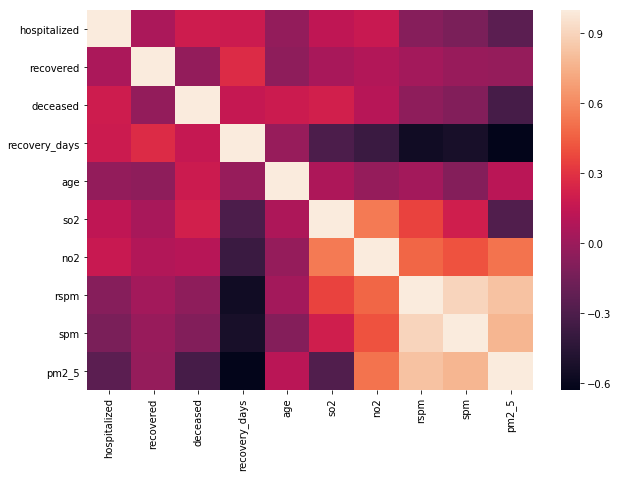

In [57]:
display(toggle_input())
ax, fig = plt.subplots(1,1, figsize=(10, 7))
sns.heatmap(data=city_complete.corr())

Recovery seems to take longer when pollutant levels are high. But recovery_days data is present for only 20 cities, so it's not reliable.

Fitting a regression model on the data doesn't seem right. Until further data is made available, the analysis will be halted.
<br>Hope to revisit this someday!

## Acknowledgements:

### Data Sources (Used):

<strong><u>COVID DATA</u></strong>

Covid data has been taken from the following kaggle dataset. This data has been collected from official sources as mentioned <br>below. You can also follow this <a href="https://www.kaggle.com/imdevskp/covid19-corona-virus-india-dataset">link</a> for <br>more details.

**complete.csv**

<br>Data is collected from India Health Ministry Website: https://www.mohfw.gov.in/
<br>Each row contains data for each state with at least 1 confirmed case for each each
<br>Each column represent different cases

**patients_data.csv**

<br>Data is collected from https://bit.ly/patientdb which is a crowd sourced data base
<br>The data source also powers the dashboard at https://www.covid19india.org/
<br>Data is still a work in progress

**Credits**

<br>Data from India Health Ministry Website: https://www.mohfw.gov.in/
<br>Data collection methodology notebook on GitHub: https://github.com/imdevskp/covid-19-india-data
<br>COVID-19 tracker dashboard https://www.covid19india.org/
<br>Photo by Fusion Medical Animation on Unsplash: https://unsplash.com/photos/rnr8D3FNUNY

---

<strong><u>POLLUTION DATA</u></strong>

Pollution data has been taken from a kaggle dataset as well. This data has been collected from official sources as mentioned <br>below. You can follow this <a href="https://www.kaggle.com/shrutibhargava94/india-air-quality-data">link</a> for more details.

**Content**

This data is combined(across the years and states) and largely clean version of the Historical Daily Ambient Air Quality Data released by the Ministry of Environment and Forests and Central Pollution Control Board of India under the National Data Sharing and Accessibility Policy (NDSAP).

Visualization of the Mean RSPM values over the years